In [1]:
import seaborn as sns
import pandas as pd
import os

Create path variables

In [6]:
curr_dir = os.getcwd()
raw_data_dir = 'Rawdata'
raw_data_name = 'Customer Data.csv'
raw_data_path = os.path.join(curr_dir, raw_data_dir, raw_data_name)

print(curr_dir)
print(raw_data_path)

d:\FIBO\Bachelor\3rd_Year\1st_Semester\Machine_Learning_Project
d:\FIBO\Bachelor\3rd_Year\1st_Semester\Machine_Learning_Project\Rawdata\Customer Data.csv


Load Raw Data for Data Exploration

In [7]:
raw_data = pd.read_csv(raw_data_path)

Base Structure of Raw Data

In [8]:
print('Amount of features in raw_data : ' + str(len(raw_data.columns)))
raw_data.columns

Amount of features in raw_data : 18


Index(['CUST_ID', 'BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES',
       'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE',
       'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY',
       'PURCHASES_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE_FREQUENCY',
       'CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'PAYMENTS',
       'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT', 'TENURE'],
      dtype='object')

In [9]:
raw_data.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000
mean,1564.474828,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318
std,2081.531879,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000
25%,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000
50%,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000
75%,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


In [10]:
raw_data.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


In [11]:
corr_raw_data = raw_data.corr()

C:\Users\newth\AppData\Local\Temp\ipykernel_13568\559288126.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_raw_data = raw_data.corr()


In [17]:
low_corr_coef = []
for column_name in corr_raw_data.columns:
    for index_name in corr_raw_data.index:
        if (((corr_raw_data.loc[column_name, index_name] < 0.5) | (corr_raw_data.loc[column_name, index_name] >= -0.5)) and (column_name != index_name)):
            print(str(column_name) + ' : ' + str(index_name))
            low_corr_coef.append(index_name)
low_corr_coef = pd.unique(low_corr_coef).tolist()

BALANCE : BALANCE_FREQUENCY
BALANCE : PURCHASES
BALANCE : ONEOFF_PURCHASES
BALANCE : INSTALLMENTS_PURCHASES
BALANCE : CASH_ADVANCE
BALANCE : PURCHASES_FREQUENCY
BALANCE : ONEOFF_PURCHASES_FREQUENCY
BALANCE : PURCHASES_INSTALLMENTS_FREQUENCY
BALANCE : CASH_ADVANCE_FREQUENCY
BALANCE : CASH_ADVANCE_TRX
BALANCE : PURCHASES_TRX
BALANCE : CREDIT_LIMIT
BALANCE : PAYMENTS
BALANCE : MINIMUM_PAYMENTS
BALANCE : PRC_FULL_PAYMENT
BALANCE : TENURE
BALANCE_FREQUENCY : BALANCE
BALANCE_FREQUENCY : PURCHASES
BALANCE_FREQUENCY : ONEOFF_PURCHASES
BALANCE_FREQUENCY : INSTALLMENTS_PURCHASES
BALANCE_FREQUENCY : CASH_ADVANCE
BALANCE_FREQUENCY : PURCHASES_FREQUENCY
BALANCE_FREQUENCY : ONEOFF_PURCHASES_FREQUENCY
BALANCE_FREQUENCY : PURCHASES_INSTALLMENTS_FREQUENCY
BALANCE_FREQUENCY : CASH_ADVANCE_FREQUENCY
BALANCE_FREQUENCY : CASH_ADVANCE_TRX
BALANCE_FREQUENCY : PURCHASES_TRX
BALANCE_FREQUENCY : CREDIT_LIMIT
BALANCE_FREQUENCY : PAYMENTS
BALANCE_FREQUENCY : MINIMUM_PAYMENTS
BALANCE_FREQUENCY : PRC_FULL_PAYMENT
B

In [18]:
print(len(low_corr_coef))
print(sorted(low_corr_coef))

17
['BALANCE', 'BALANCE_FREQUENCY', 'CASH_ADVANCE', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'CREDIT_LIMIT', 'INSTALLMENTS_PURCHASES', 'MINIMUM_PAYMENTS', 'ONEOFF_PURCHASES', 'ONEOFF_PURCHASES_FREQUENCY', 'PAYMENTS', 'PRC_FULL_PAYMENT', 'PURCHASES', 'PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY', 'PURCHASES_TRX', 'TENURE']


In [58]:
low_corr_data = raw_data[low_corr_coef]

In [59]:
low_corr_data.describe()

,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,BALANCE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000,8950.000000
mean,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318,1564.474828
std,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331,2081.531879
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000,0.000000
25%,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000,128.281915
50%,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000,873.385231
75%,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000,2054.140036
max,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000,19043.138560


In [61]:
balance_class = pd.qcut(low_corr_data['BALANCE'], 4, labels=False)
balance_class = pd.DataFrame(balance_class.values, columns=['BALANCE_CLASS'])
balance_class.describe()

,BALANCE_CLASS
count,8950.000000
mean,1.500000
std,1.118196
min,0.000000
25%,0.250000
50%,1.500000
75%,2.750000
max,3.000000


In [67]:
balance_segment = pd.concat([low_corr_data, balance_class], axis=1)
balance_segment.describe()

,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,BALANCE,BALANCE_CLASS
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000,8950.000000,8950.000000
mean,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318,1564.474828,1.500000
std,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331,2081.531879,1.118196
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000,0.000000,0.000000
25%,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000,128.281915,0.250000
50%,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000,873.385231,1.500000
75%,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000,2054.140036,2.750000
max,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000,19043.138560,3.000000


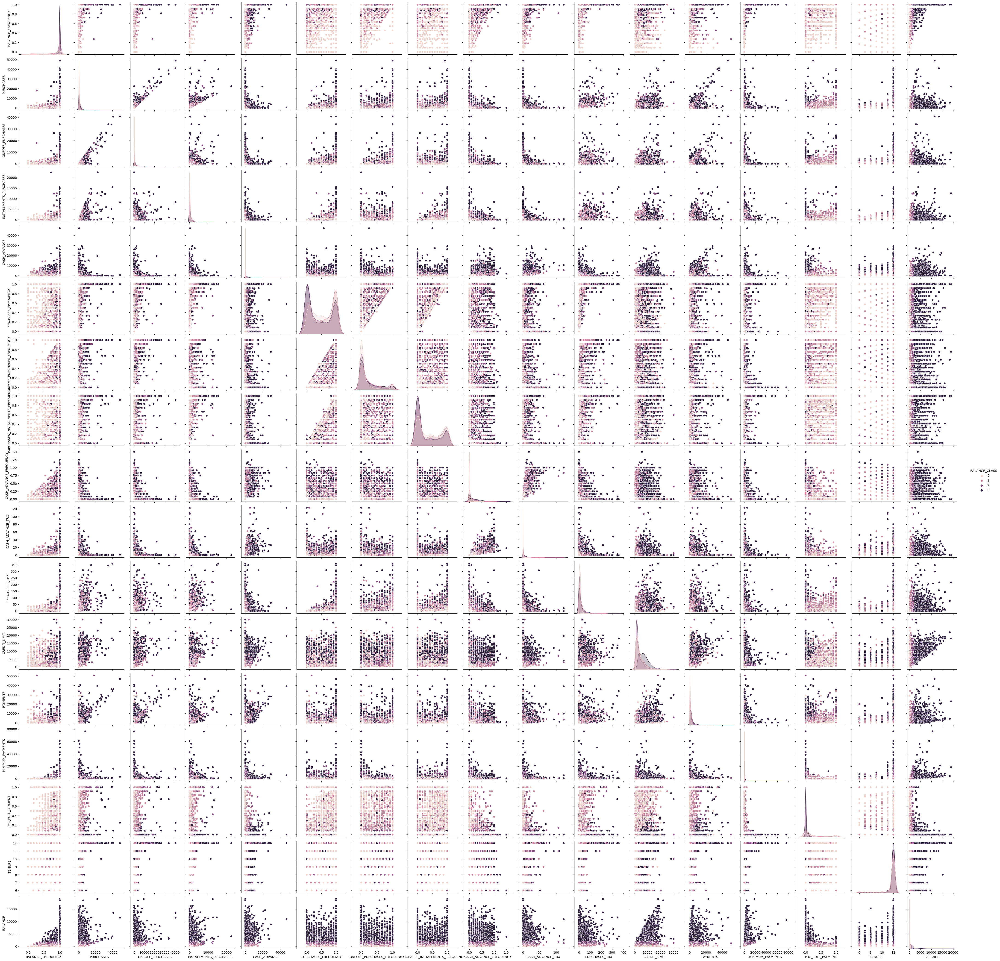

In [68]:
sns.pairplot(balance_segment, hue='BALANCE_CLASS')

In [74]:
purchase_class = pd.qcut(low_corr_data['PURCHASES'], 4, labels=False)
purchase_class = pd.DataFrame(purchase_class.values, columns=['PURCHASES_CLASS'])
purchase_class.describe()

,PURCHASES_CLASS
count,8950.000000
mean,1.500000
std,1.118196
min,0.000000
25%,0.250000
50%,1.500000
75%,2.750000
max,3.000000


In [75]:
purchase_segment = pd.concat([low_corr_data, purchase_class], axis=1)
purchase_segment.describe()

,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,BALANCE,PURCHASES_CLASS
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000,8950.000000,8950.000000
mean,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318,1564.474828,1.500000
std,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331,2081.531879,1.118196
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000,0.000000,0.000000
25%,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000,128.281915,0.250000
50%,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000,873.385231,1.500000
75%,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000,2054.140036,2.750000
max,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000,19043.138560,3.000000


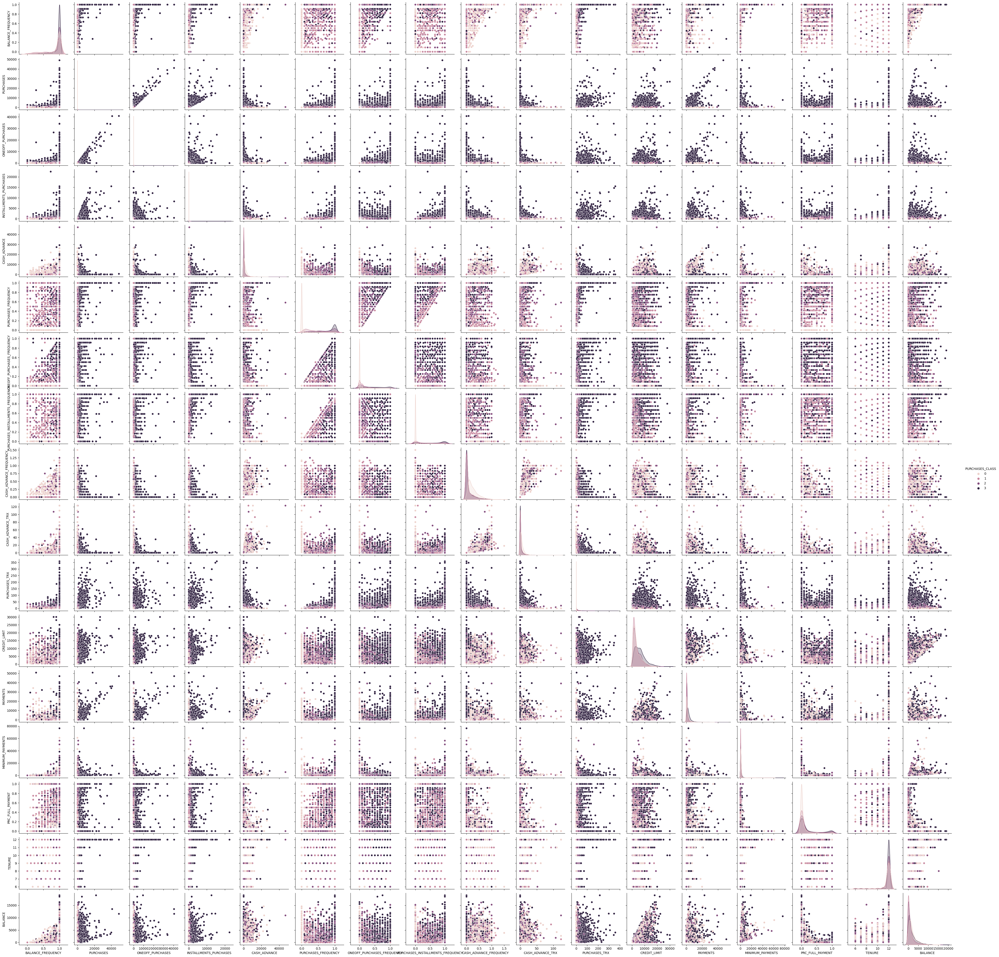

In [76]:
sns.pairplot(purchase_segment, hue='PURCHASES_CLASS')

In [92]:
oneoff_purchase_class = pd.qcut(low_corr_data['ONEOFF_PURCHASES'], 2, labels=False)
oneoff_purchase_class = pd.DataFrame(oneoff_purchase_class.values, columns=['ONEOFF_PURCHASES_CLASS'])
oneoff_purchase_class.describe()

,ONEOFF_PURCHASES_CLASS
count,8950.000000
mean,0.499888
std,0.500028
min,0.000000
25%,0.000000
50%,0.000000
75%,1.000000
max,1.000000


In [93]:
oneoff_purchase_segment = pd.concat([low_corr_data, oneoff_purchase_class], axis=1)
oneoff_purchase_segment.describe()

,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,BALANCE,ONEOFF_PURCHASES_CLASS
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000,8950.000000,8950.000000
mean,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318,1564.474828,0.499888
std,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331,2081.531879,0.500028
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000,0.000000,0.000000
25%,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000,128.281915,0.000000
50%,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000,873.385231,0.000000
75%,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000,2054.140036,1.000000
max,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000,19043.138560,1.000000


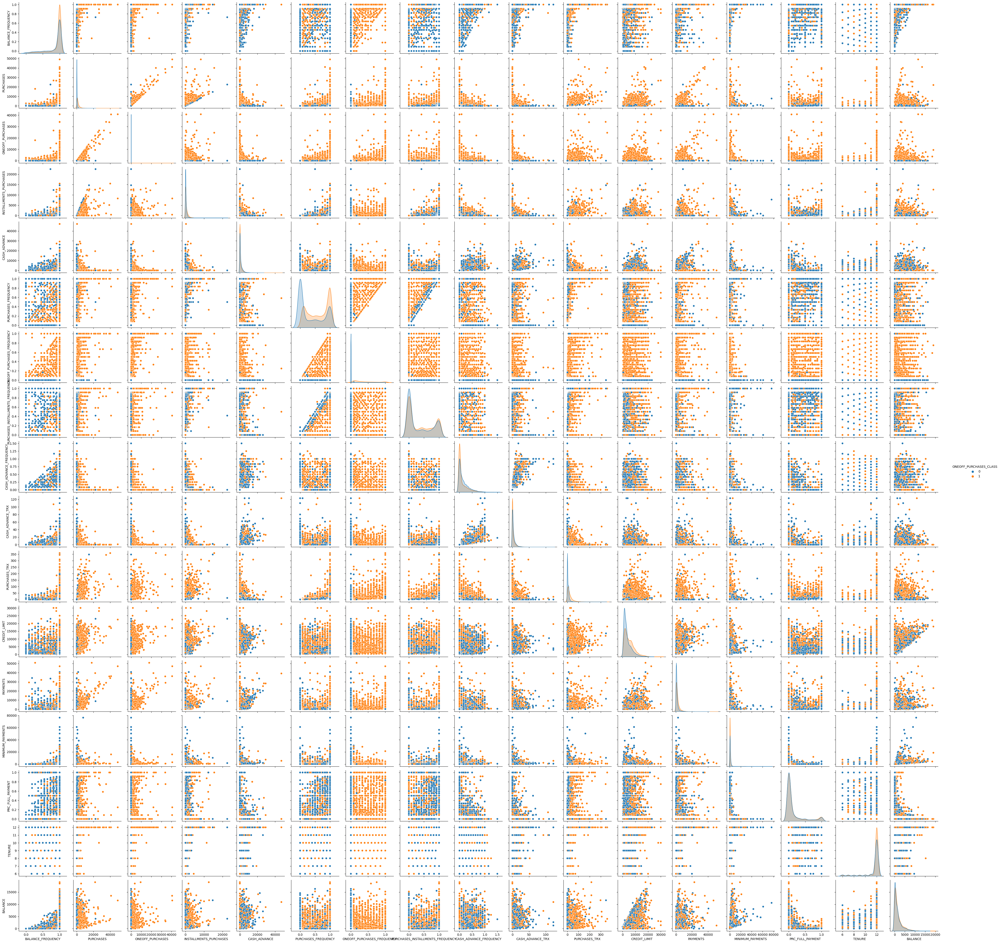

In [94]:
sns.pairplot(oneoff_purchase_segment, hue='ONEOFF_PURCHASES_CLASS')

In [77]:
credit_limit_class = pd.qcut(low_corr_data['CREDIT_LIMIT'], 4, labels=False)
credit_limit_class = pd.DataFrame(credit_limit_class.values, columns=['CREDIT_LIMIT_CLASS'])
credit_limit_class.describe()

,CREDIT_LIMIT_CLASS
count,8949.000000
mean,1.461392
std,1.101971
min,0.000000
25%,0.000000
50%,1.000000
75%,2.000000
max,3.000000


In [78]:
credit_limit_segment = pd.concat([low_corr_data, credit_limit_class], axis=1)
credit_limit_segment.describe()

,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,BALANCE,CREDIT_LIMIT_CLASS
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000,8950.000000,8949.000000
mean,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318,1564.474828,1.461392
std,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331,2081.531879,1.101971
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000,0.000000,0.000000
25%,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000,128.281915,0.000000
50%,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000,873.385231,1.000000
75%,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000,2054.140036,2.000000
max,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000,19043.138560,3.000000


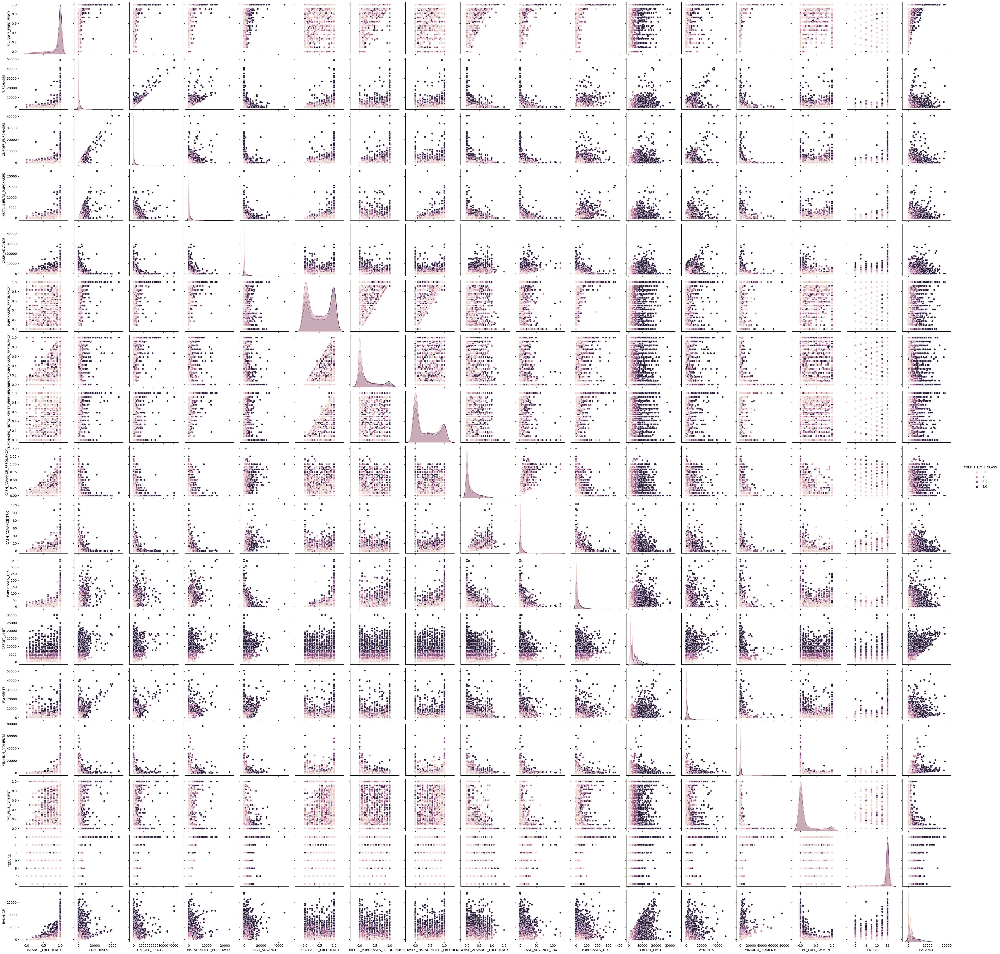

In [79]:
sns.pairplot(credit_limit_segment, hue='CREDIT_LIMIT_CLASS')

In [80]:
payment_class = pd.qcut(low_corr_data['PAYMENTS'], 4, labels=False)
payment_class = pd.DataFrame(payment_class.values, columns=['PAYMENT_CLASS'])
payment_class.describe()

,PAYMENT_CLASS
count,8950.000000
mean,1.500000
std,1.118196
min,0.000000
25%,0.250000
50%,1.500000
75%,2.750000
max,3.000000


In [81]:
payment_segment = pd.concat([low_corr_data, payment_class], axis=1)
payment_segment.describe()

,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,BALANCE,PAYMENT_CLASS
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000,8950.000000,8950.000000
mean,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318,1564.474828,1.500000
std,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331,2081.531879,1.118196
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000,0.000000,0.000000
25%,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000,128.281915,0.250000
50%,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000,873.385231,1.500000
75%,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000,2054.140036,2.750000
max,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000,19043.138560,3.000000


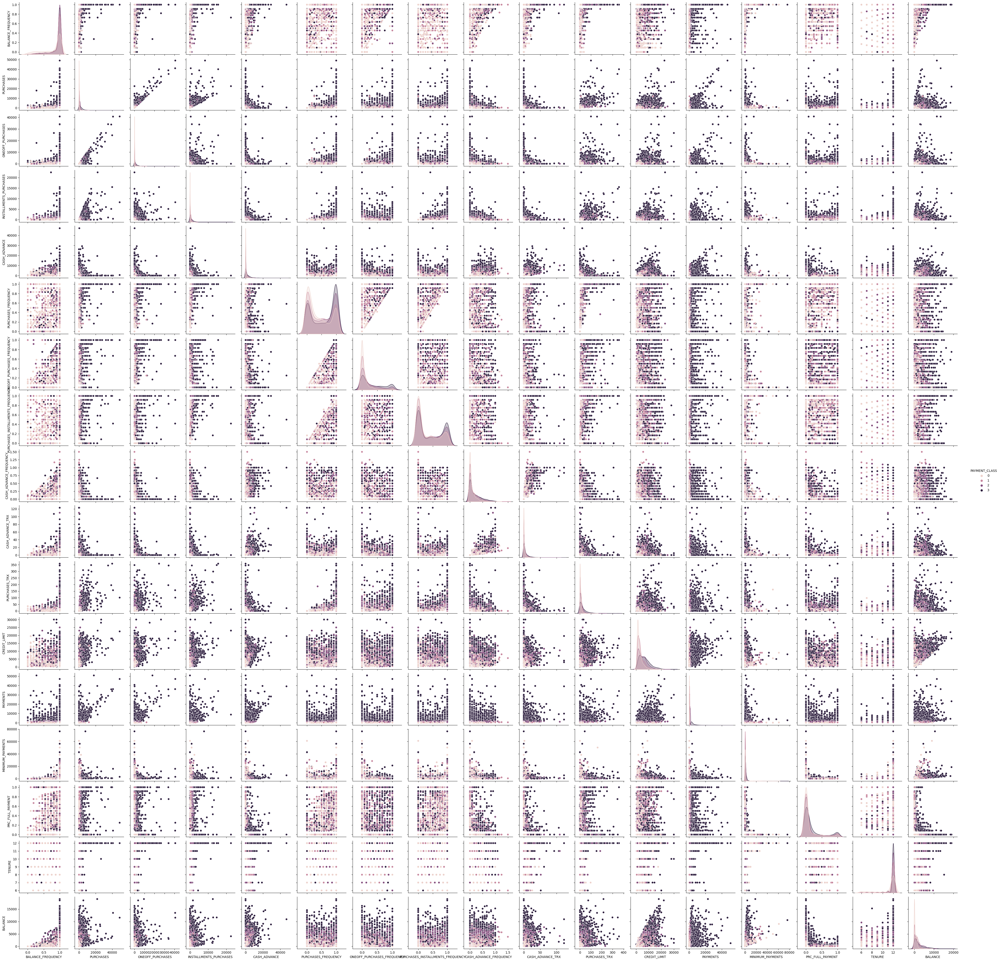

In [83]:
sns.pairplot(payment_segment, hue='PAYMENT_CLASS')

In [101]:
for name in low_corr_coef:
    if name.find('FREQUENCY') != -1:
        low_corr_coef.remove(name)

In [102]:
print(low_corr_coef)

['PURCHASES', 'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'ONEOFF_PURCHASES_FREQUENCY', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT', 'TENURE', 'BALANCE']
